In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
df = pd.read_csv('/content/AirQualityUCI.csv')
df = df.replace(-200, pd.NA)

In [ ]:
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/3/2004,18.00.00,2.6,1360,150.0,11.9,1046,166,1056,113,1692,1268.0,13.6,48.9,0.7578
1,10/3/2004,19.00.00,2.0,1292,112.0,9.4,955,103,1174,92,1559,972.0,13.3,47.7,0.7255
2,10/3/2004,20.00.00,2.2,1402,88.0,9.0,939,131,1140,114,1555,1074.0,11.9,54.0,0.7502
3,10/3/2004,21.00.00,2.2,1376,80.0,9.2,948,172,1092,122,1584,1203.0,11.0,60.0,0.7867
4,10/3/2004,22.00.00,1.6,1272,51.0,6.5,836,131,1205,116,1490,1110.0,11.2,59.6,0.7888


In [ ]:
df.describe().T

,count,unique,top,freq
Date,9357,391,21/09/2004,24
Time,9357,26,18.00.00,390
CO(GT),7675.0,97.0,1.0,305.0
PT08.S1(CO),8990,1041,973,30
NMHC(GT),915.0,430.0,66.0,14.0
C6H6(GT),8991.0,408.0,3.6,84.0
PT08.S2(NMHC),8990,1245,853,25
NOx(GT),7719,925,89,41
PT08.S3(NOx),8990,1221,767,25
NO2(GT),7716,284,97,78


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9357 entries, 0 to 9356
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Date           9357 non-null   object
 1   Time           9357 non-null   object
 2   CO(GT)         7675 non-null   object
 3   PT08.S1(CO)    8990 non-null   object
 4   NMHC(GT)       915 non-null    object
 5   C6H6(GT)       8991 non-null   object
 6   PT08.S2(NMHC)  8990 non-null   object
 7   NOx(GT)        7719 non-null   object
 8   PT08.S3(NOx)   8990 non-null   object
 9   NO2(GT)        7716 non-null   object
 10  PT08.S4(NO2)   8991 non-null   object
 11  PT08.S5(O3)    8991 non-null   object
 12  T              8991 non-null   object
 13  RH             8991 non-null   object
 14  AH             8990 non-null   object
dtypes: object(15)
memory usage: 1.1+ MB


In [ ]:
df.isnull().sum()

Date                0
Time                0
CO(GT)           1682
PT08.S1(CO)       367
NMHC(GT)         8442
C6H6(GT)          366
PT08.S2(NMHC)     367
NOx(GT)          1638
PT08.S3(NOx)      367
NO2(GT)          1641
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                367
dtype: int64

In [ ]:
## We can see NMHC(GT) column is missing more that 75% of the data so dropping that column is better
## than imputing because imputing might disturb the data

df = df.drop(["NMHC(GT)"], axis=1)

In [ ]:
df.columns

Index(['Date', 'Time', 'CO(GT)', 'PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH'],
      dtype='object')

In [ ]:
## imputing columns having less than 5% of the missing values with mean value

df[['PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'PT08.S4(NO2)', 'PT08.S5(O3)','T', 'RH', 'AH']] = df[['PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'PT08.S4(NO2)', 'PT08.S5(O3)','T', 'RH', 'AH']].fillna(df[['PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'PT08.S4(NO2)', 'PT08.S5(O3)','T', 'RH', 'AH']].mean())

In [ ]:
## Droping rows having missing values from columns having missing values more or upto 25%
## if imputed might disturb our analysis

df = df.dropna()

In [ ]:
df.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

In [ ]:
df.head()

,Date,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/3/2004,18.00.00,2.6,1360.0,11.9,1046.0,166,1056.0,113,1692.0,1268.0,13.6,48.9,0.7578
1,10/3/2004,19.00.00,2.0,1292.0,9.4,955.0,103,1174.0,92,1559.0,972.0,13.3,47.7,0.7255
2,10/3/2004,20.00.00,2.2,1402.0,9.0,939.0,131,1140.0,114,1555.0,1074.0,11.9,54.0,0.7502
3,10/3/2004,21.00.00,2.2,1376.0,9.2,948.0,172,1092.0,122,1584.0,1203.0,11.0,60.0,0.7867
4,10/3/2004,22.00.00,1.6,1272.0,6.5,836.0,131,1205.0,116,1490.0,1110.0,11.2,59.6,0.7888


In [ ]:
# Checking for unique values in 'Date' and 'Time' that may cause issues
unique_dates = df['Date'].unique()
unique_times = df['Time'].unique()

# Display some of the unique values to understand the issue
unique_dates[:5], unique_times[:5]

(array(['10/3/2004', '11/3/2004', '12/3/2004', '13/03/2004', '14/03/2004'],
       dtype=object),
 array(['18.00.00', '19.00.00', '20.00.00', '21.00.00', '22.00.00'],
       dtype=object))

### Exploratory Data Analysis:

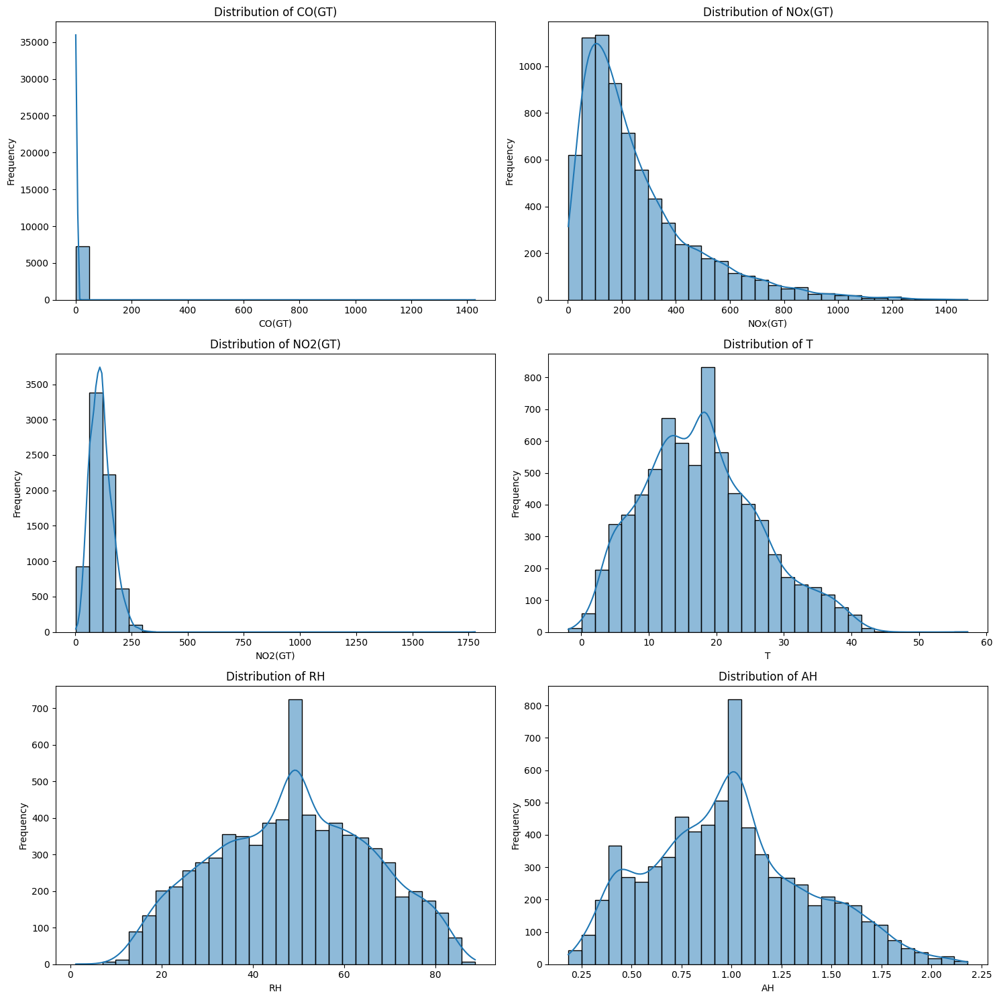

In [ ]:
# Proceed with distribution plots for selected variables
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(15, 15))
variables_to_plot = ['CO(GT)', 'NOx(GT)', 'NO2(GT)', 'T', 'RH', 'AH']

for ax, var in zip(axs.flat, variables_to_plot):
    # Temporarily convert to numeric, ignoring errors to bypass -200 and other non-numeric issues
    sns.histplot(pd.to_numeric(df[var], errors='coerce'), bins=30, ax=ax, kde=True)
    ax.set_title(f'Distribution of {var}')
    ax.set_ylabel('Frequency')
    ax.set_xlabel(var)

plt.tight_layout()
plt.show()

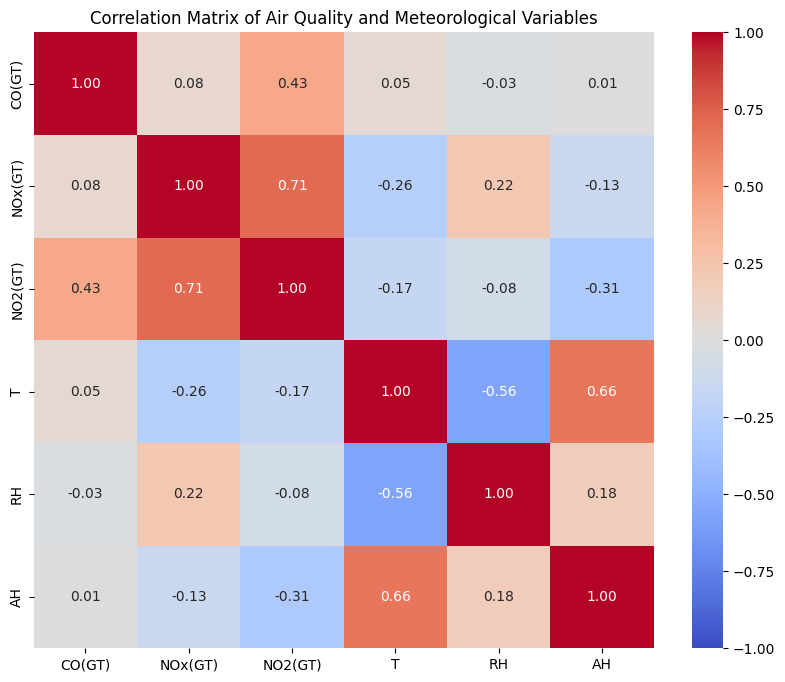

In [ ]:
numeric_columns = ['CO(GT)', 'NOx(GT)', 'NO2(GT)', 'T', 'RH', 'AH']
df_numeric = df[numeric_columns].apply(pd.to_numeric, errors='coerce')

# Calculate correlation matrix
correlation_matrix = df_numeric.corr()

# Plotting the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title('Correlation Matrix of Air Quality and Meteorological Variables')
plt.show()

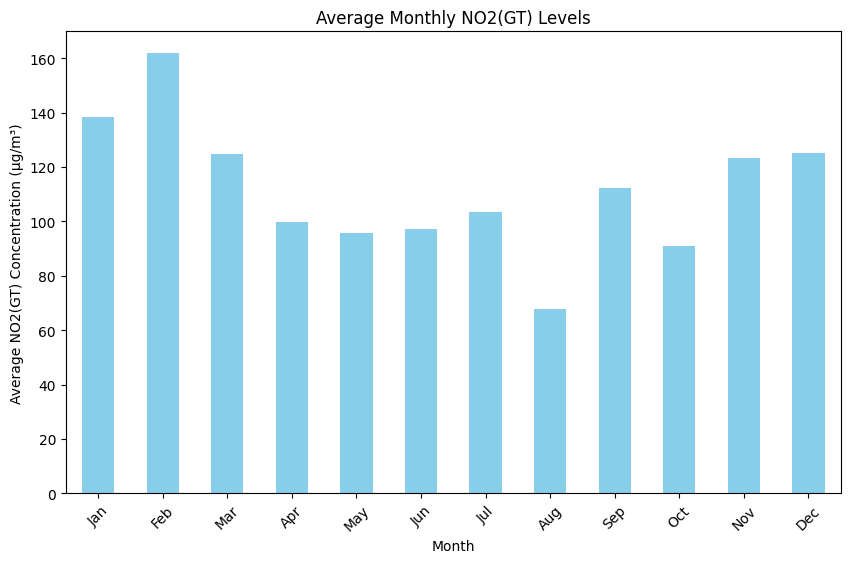

In [ ]:
# Additionally, let's look into temporal trends for one of the pollutants, say NO2(GT), across different months.
# Due to previous issues with datetime conversion, we'll use the 'Date' column as is, extracting the month for grouping.

# Extract month from the 'Date' column (assuming format DD/MM/YYYY)
df['Month'] = df['Date'].apply(lambda x: int(x.split('/')[1]) if pd.notna(x) else pd.NA)

# Group by month and calculate average NO2(GT) levels
monthly_no2 = df.groupby('Month')['NO2(GT)'].mean().dropna()

# Plotting the average NO2(GT) levels by month
plt.figure(figsize=(10, 6))
monthly_no2.plot(kind='bar', color='skyblue')
plt.title('Average Monthly NO2(GT) Levels')
plt.xlabel('Month')
plt.ylabel('Average NO2(GT) Concentration (µg/m³)')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=45)
plt.show()

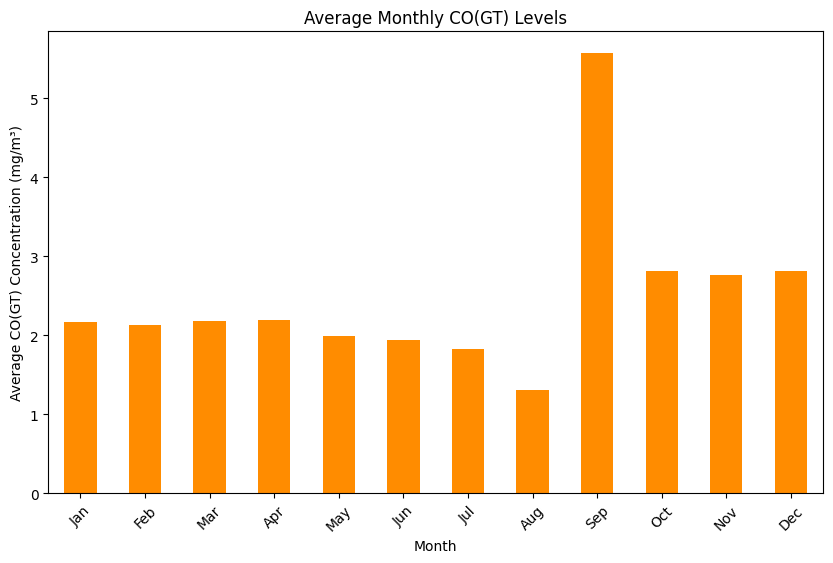

In [ ]:
# To delve deeper into the analysis of Carbon Monoxide (CO) levels, let's examine:
# 1. Temporal trends of CO levels across different months.
# 2. The relationship between CO levels and temperature (T), as temperature could influence the dispersion of pollutants.

# Extracting month from 'Date' for grouping, similar to the NO2 analysis, if not already done
if 'Month' not in df:
    df['Month'] = df['Date'].apply(lambda x: int(x.split('/')[1]) if pd.notna(x) else pd.NA)

# Group by month and calculate average CO(GT) levels
monthly_co = df.groupby('Month')['CO(GT)'].mean().dropna()

# Plotting the average CO(GT) levels by month
plt.figure(figsize=(10, 6))
monthly_co.plot(kind='bar', color='darkorange')
plt.title('Average Monthly CO(GT) Levels')
plt.xlabel('Month')
plt.ylabel('Average CO(GT) Concentration (mg/m³)')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=45)
plt.show()

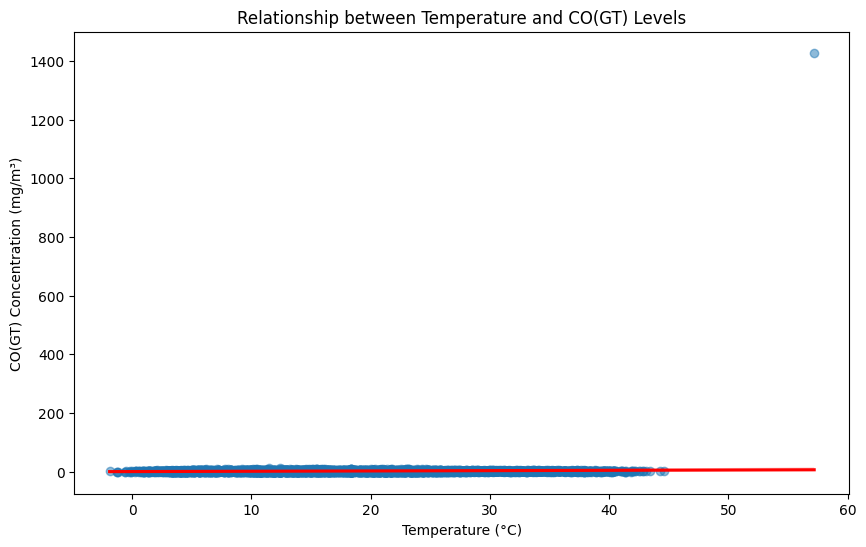

In [ ]:
# Exploring the relationship between CO levels and Temperature
# Creating a scatter plot with a regression line to visualize this relationship
plt.figure(figsize=(10, 6))
sns.regplot(x='T', y='CO(GT)', data=df_numeric, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.title('Relationship between Temperature and CO(GT) Levels')
plt.xlabel('Temperature (°C)')
plt.ylabel('CO(GT) Concentration (mg/m³)')
plt.show()

In [ ]:
pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.9/357.9 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 3.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 14.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=9ab2a961eb5a576459f933f81e1a35e116cec3236bbb34d4248fbfce2413fc12
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.13.1
    Uninstalling seaborn-0.13.1:
      Successfully uninstalled seaborn-0.13.1


In [ ]:
pip install pydantic-settings

In [ ]:
pip install --upgrade pydantic

In [ ]:
pip install --upgrade pandas_profiling

In [ ]:
pip install ydata-profiling

In [ ]:
from ydata_profiling import ProfileReport

In [ ]:
profile = df.profile_report(title='Air Quality Dataset Analysis')
profile.to_file("Air_Quality_analysis.html")

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:354: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
from IPython.display import display, HTML

display(HTML("Air_Quality_analysis.html"))

Number of variables,15
Number of observations,7259
Missing cells,0
Missing cells (%),0.0%
Duplicate rows,0
Duplicate rows (%),0.0%
Total size in memory,1.1 MiB
Average record size in memory,164.4 B
DateTime,1
Categorical,1
Numeric,13


In [ ]:
import sweetviz as sv

In [ ]:
report = sv.analyze(df)


                                             |          | [  0%]   00:00 -> (? left)

In [ ]:
from IPython.display import IFrame

report.show_html('report.html')

Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



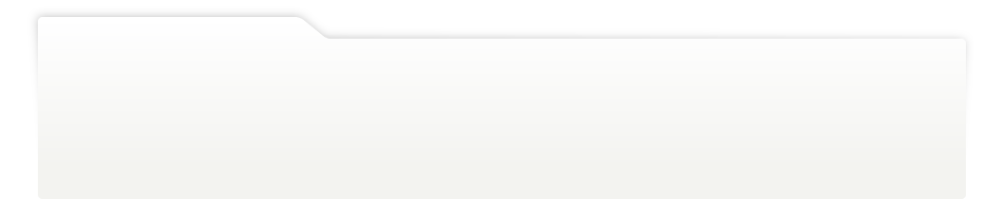
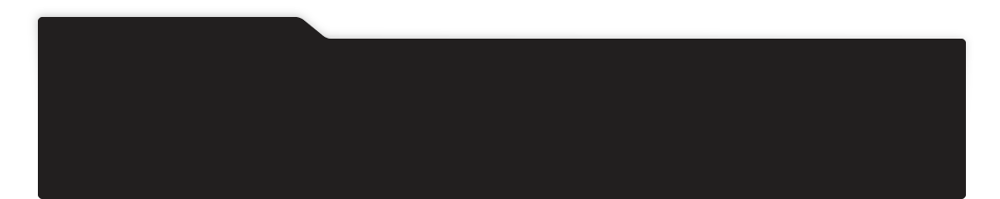
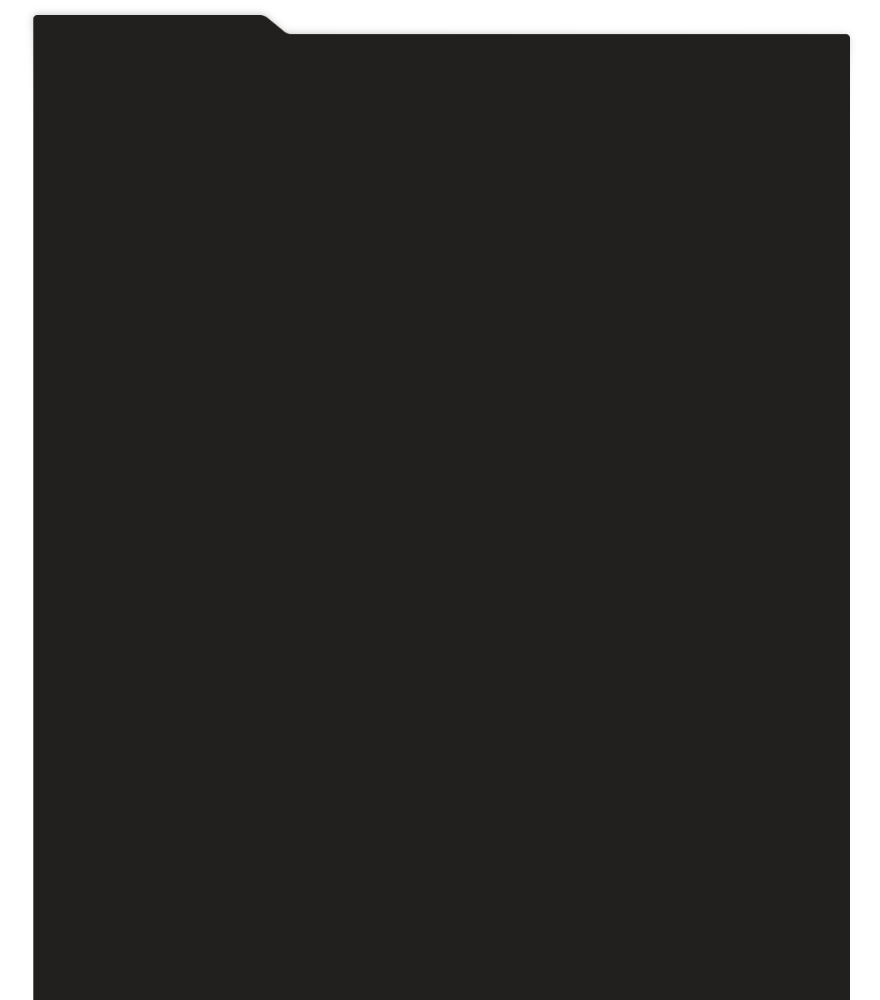
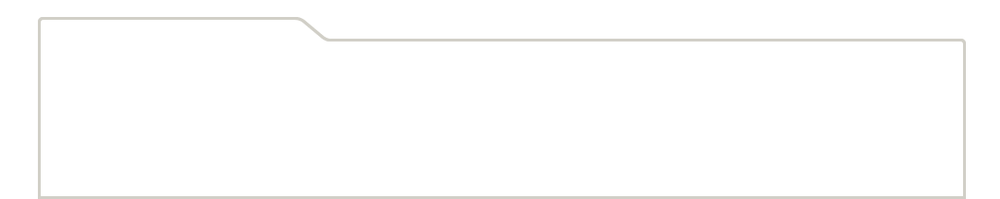
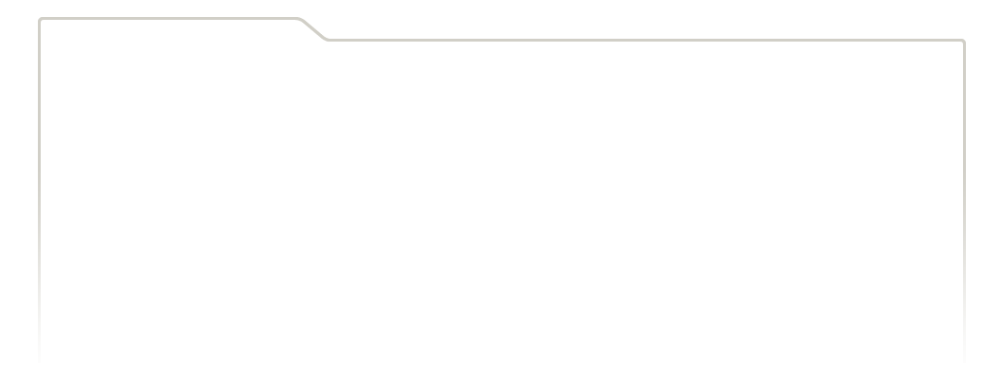
...
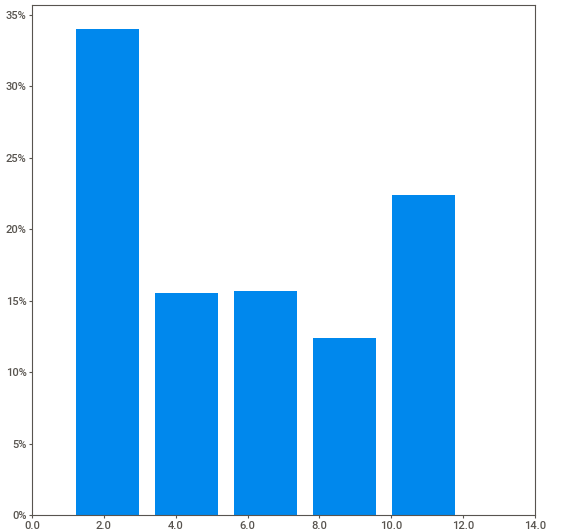
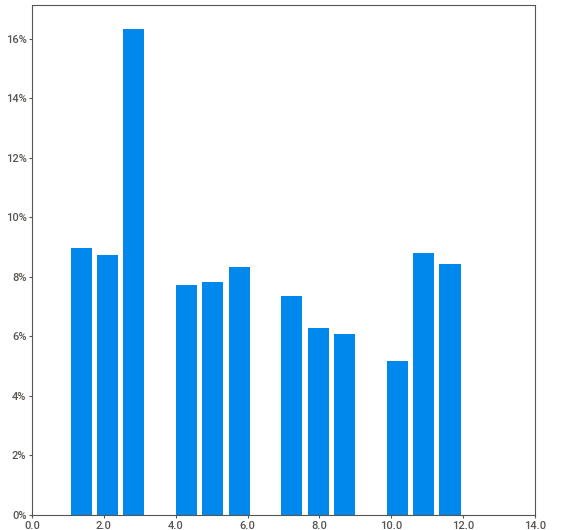
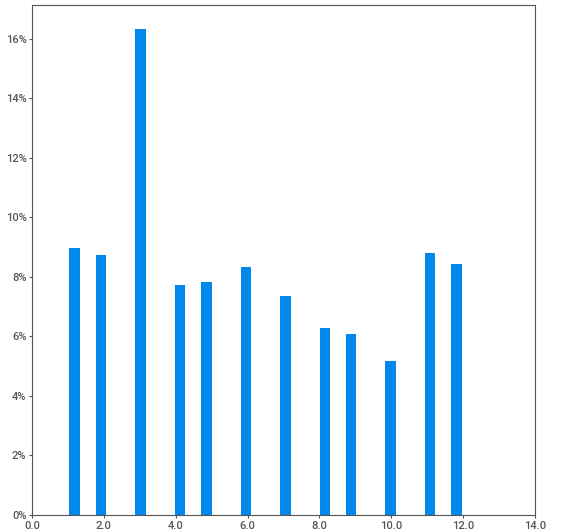
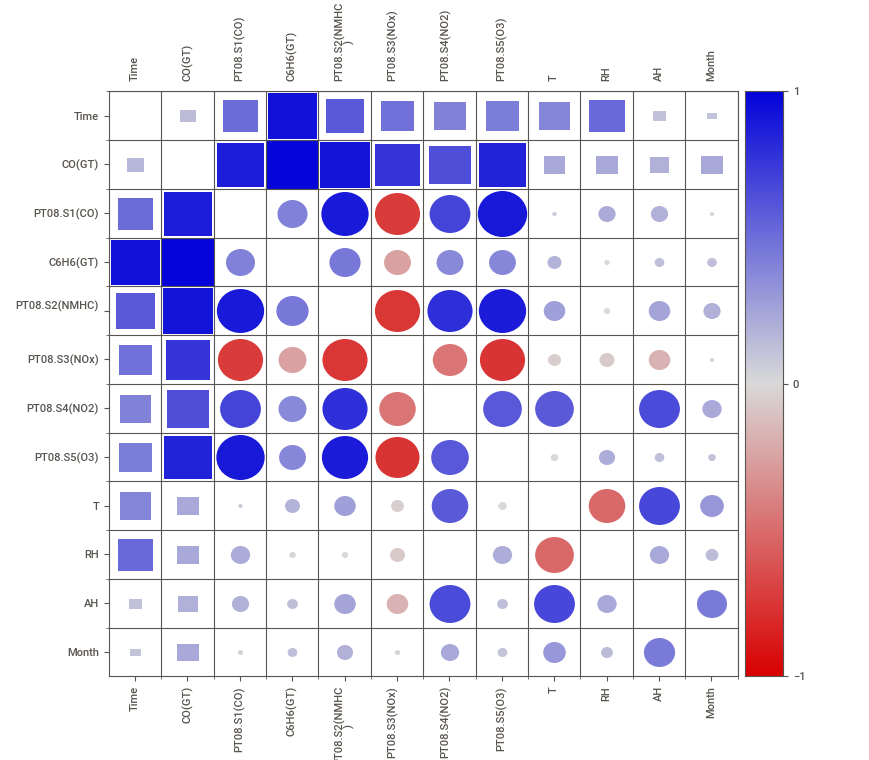
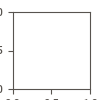

In [ ]:
display(HTML("report.html"))

### Convert the timestamp information to a datetime object in Pandas¶

In [ ]:
#Merge the 'Date' and 'Time' columns to create a unified 'datetime' column
df['datetime'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%d/%m/%Y %H.%M.%S', errors='coerce')

In [ ]:
df = df.dropna()

In [ ]:
df.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
Month            0
datetime         0
dtype: int64

#### Convering the object columns to float for analysis

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7258 entries, 0 to 9356
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           7258 non-null   object        
 1   Time           7258 non-null   object        
 2   CO(GT)         7258 non-null   object        
 3   PT08.S1(CO)    7258 non-null   float64       
 4   C6H6(GT)       7258 non-null   float64       
 5   PT08.S2(NMHC)  7258 non-null   float64       
 6   NOx(GT)        7258 non-null   object        
 7   PT08.S3(NOx)   7258 non-null   float64       
 8   NO2(GT)        7258 non-null   object        
 9   PT08.S4(NO2)   7258 non-null   float64       
 10  PT08.S5(O3)    7258 non-null   float64       
 11  T              7258 non-null   float64       
 12  RH             7258 non-null   float64       
 13  AH             7258 non-null   float64       
 14  Month          7258 non-null   int64         
 15  datetime       7258 non-nu

In [ ]:
# List of columns to convert to float
columns_to_convert = ['CO(GT)', 'PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH']

# Convert columns to float using a for loop
for col in columns_to_convert:
    df[col] = df[col].astype(float)

<ipython-input-48-a441f16a7250>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[col] = df[col].astype(float)
<ipython-input-48-a441f16a7250>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[col] = df[col].astype(float)
<ipython-input-48-a441f16a7250>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7258 entries, 0 to 9356
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           7258 non-null   object        
 1   Time           7258 non-null   object        
 2   CO(GT)         7258 non-null   float64       
 3   PT08.S1(CO)    7258 non-null   float64       
 4   C6H6(GT)       7258 non-null   float64       
 5   PT08.S2(NMHC)  7258 non-null   float64       
 6   NOx(GT)        7258 non-null   float64       
 7   PT08.S3(NOx)   7258 non-null   float64       
 8   NO2(GT)        7258 non-null   float64       
 9   PT08.S4(NO2)   7258 non-null   float64       
 10  PT08.S5(O3)    7258 non-null   float64       
 11  T              7258 non-null   float64       
 12  RH             7258 non-null   float64       
 13  AH             7258 non-null   float64       
 14  Month          7258 non-null   int64         
 15  datetime       7258 non-nu

### Resample the data to a daily frequency, aggregating with the mean  

In [ ]:
## Dropping extra columns

df = df.drop('Date', axis=1)
df = df.drop('Time', axis=1)

In [ ]:
# Resample data to daily frequency, aggregating with mean
df.set_index('datetime', inplace=True)
data_daily = df.resample('D').mean()

In [ ]:
df.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Month
datetime,,,,,,,,,,,,,
2004-03-10 18:00:00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,3
2004-03-10 19:00:00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,3
2004-03-10 20:00:00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,3
2004-03-10 21:00:00,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,3
2004-03-10 22:00:00,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,3


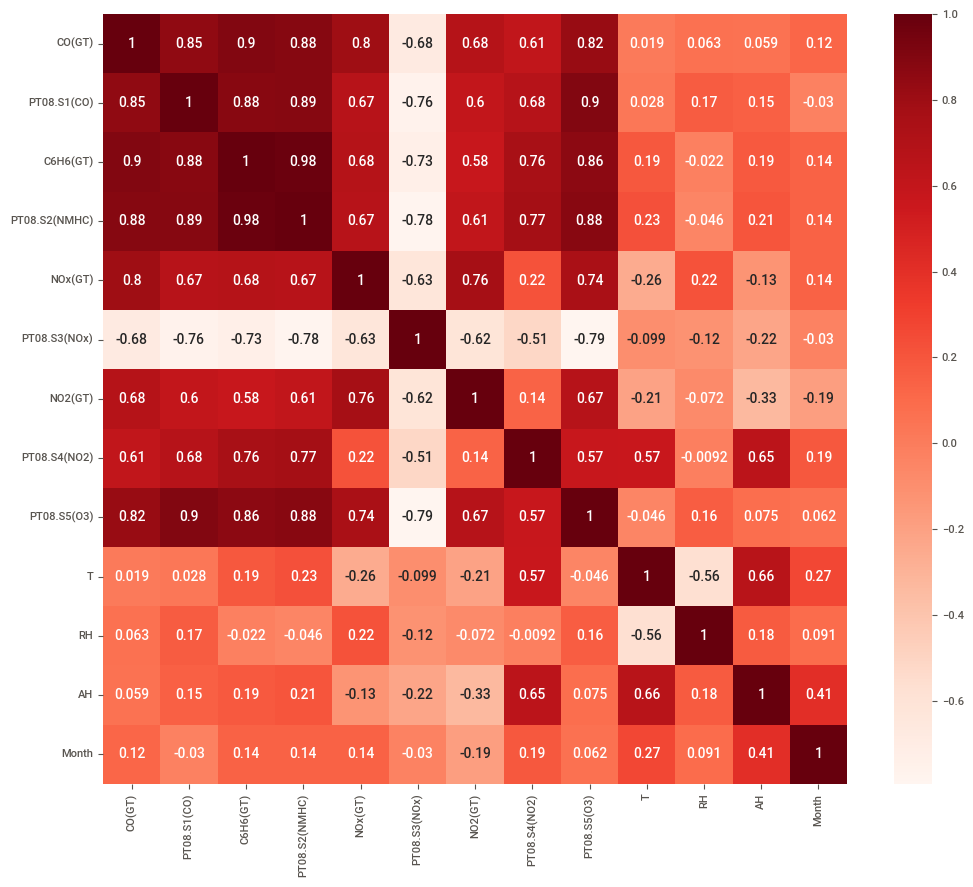

In [ ]:
#Using Pearson Correlation
plt.figure(figsize=(12,10))
cor = df.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

Text(0.5, 1.0, 'NOx & sensor S5(NOx)')

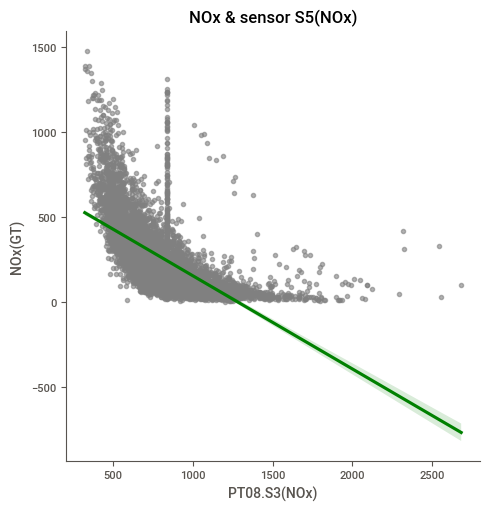

In [ ]:
# NOx vs. S5(NOx)
sns.lmplot(x='PT08.S3(NOx)',y='NOx(GT)', scatter_kws={'color':'grey','alpha':.6}, data=df,line_kws={'color':'green'})
plt.title("NOx & sensor S5(NOx)")

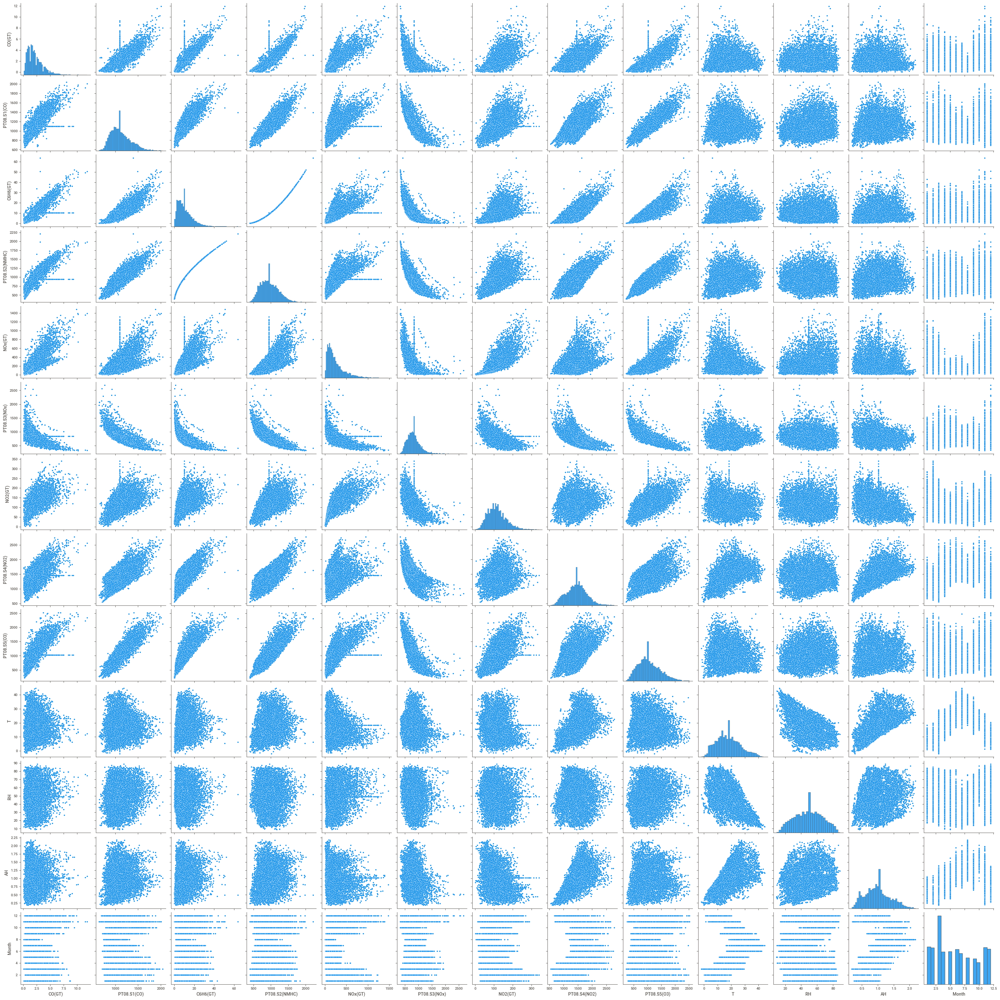

In [ ]:
sns.pairplot(df)

In [ ]:
import sweetviz as sv

In [ ]:
report = sv.analyze(df)

                                             |          | [  0%]   00:00 -> (? left)

In [ ]:
report.show_html('report.html')

Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [ ]:
# data visualization functions

def visualizeScatter(df, x, y, fill, title):
    fig = px.scatter(df,
    x=x,
    y=y,
    color=fill,
    #     facet_row=fill,
    title=title)

    fig.show()

def visualizeFilledArea(x, y, fill, hd):
    fig = px.area(df,
    x=x,
    y=y,
    color=fill,
    hover_data=[hd])

    fig.show()

def visualizeLineCharts(df, columns, x1, title):
    columns = columns

    fig = go.Figure([{
    'x': df[x1],
    'y': df[col],
    'name': col
    }  for col in columns], layout=go.Layout(title=go.layout.Title(text=title)))

    fig.show()

def showViolinPlot(x, y, x2, y2, x3, y3):
    fig, axes = plt.subplots(1,3, figsize=(25, 5))
    sns.violinplot(x=x, y=y, data=df, hue=x, palette='rocket', ax=axes[0])
    axes[0].set_title("{} by {}".format(x, y))


    sns.violinplot(x=x2, y=y2, data=df, hue=x2, palette='rocket', ax=axes[1])
    axes[1].set_title("{} by {}".format(x2, y2))


    sns.violinplot(x=x3, y=y3, data=df, hue=x3, palette='rocket', ax=axes[2])
    axes[2].set_title("{} by {}".format(x3, y3))

def displayHeatMap(dim1, dim2, title, df):
    fig=plt.figure(figsize=(dim1,dim2))
    plt.title(title)
    sns.heatmap(df, annot= True, cmap='flare')

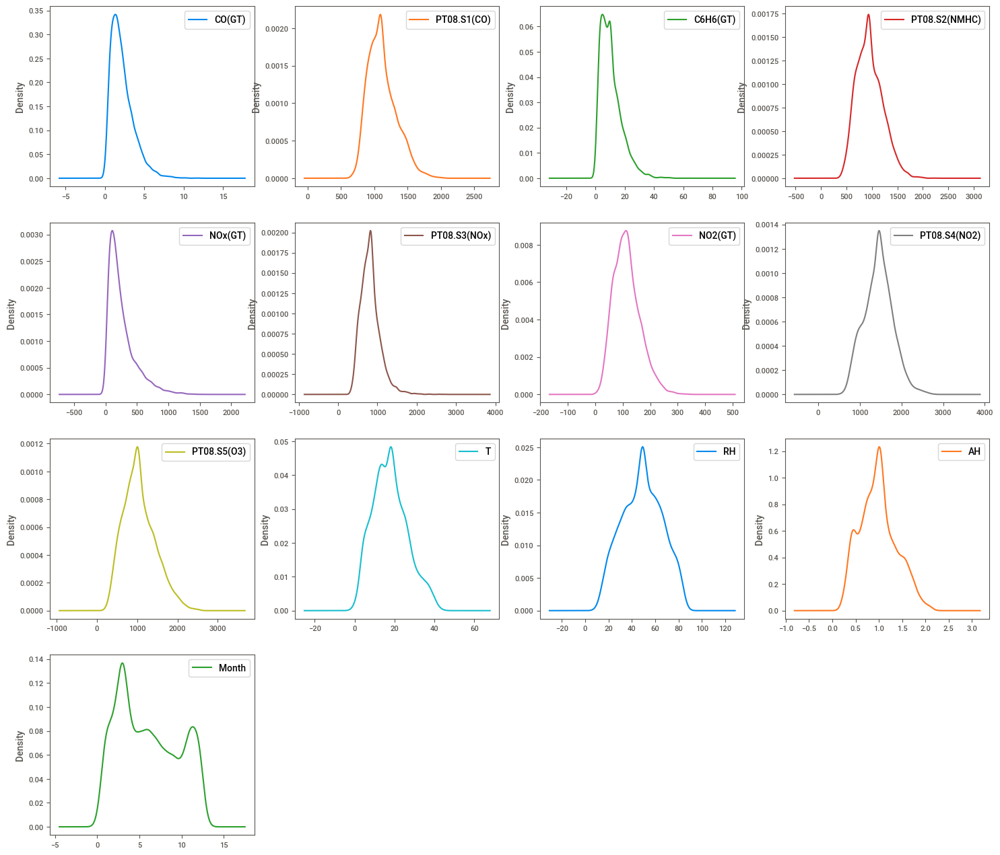

In [ ]:
plt.rcParams['figure.figsize'] = [18, 16]
df.plot(kind="density", subplots=True, layout=(4,4), sharex=False, sharey=False)
plt.show()

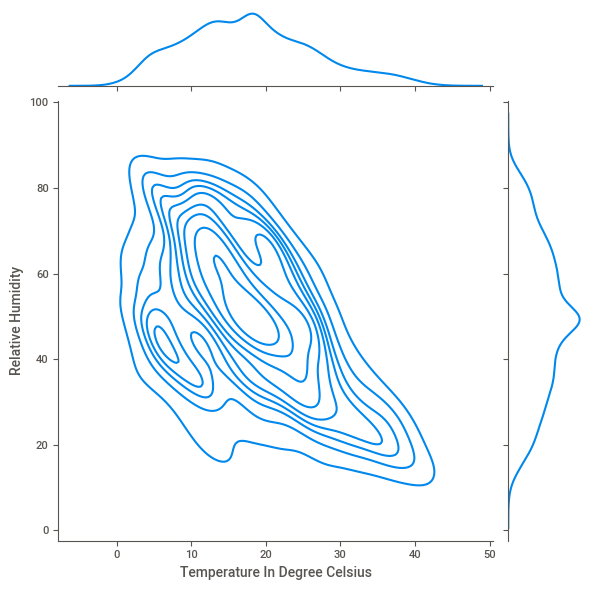

In [ ]:
sns.jointplot(x="T", y="RH", data=df,kind= "kde").set_axis_labels("Temperature In Degree Celsius", "Relative Humidity")

### Visualize the time series data for different pollutants.

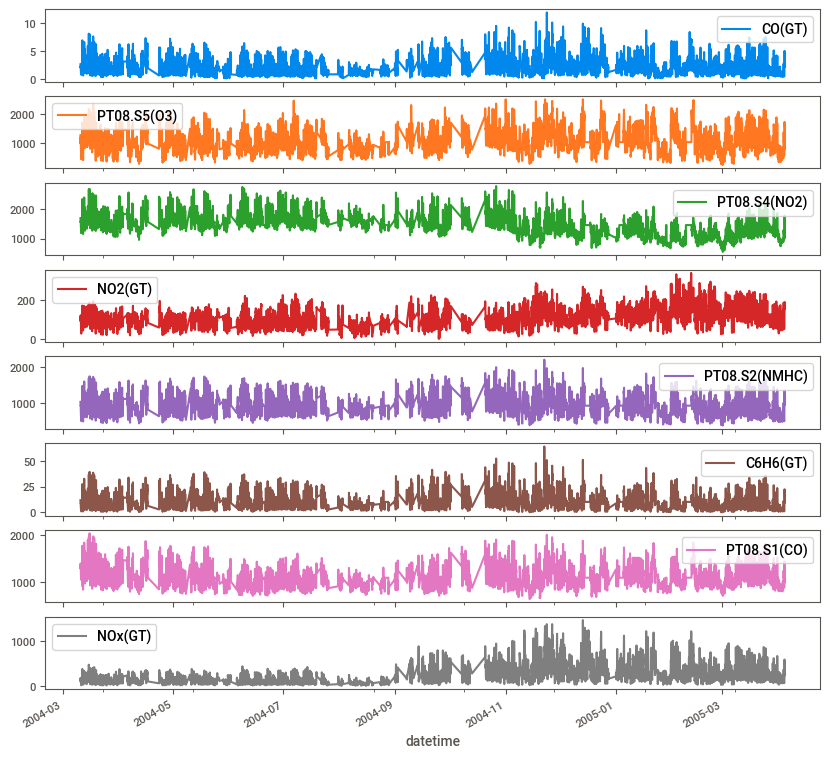

In [ ]:
# Visualize the time series data for different pollutants
pollutants = ['CO(GT)', 'PT08.S5(O3)','PT08.S4(NO2)','NO2(GT)','PT08.S2(NMHC)','C6H6(GT)','PT08.S1(CO)', 'NOx(GT)']  # Example pollutants
df[pollutants].plot(subplots=True, figsize=(10, 10))
plt.show()

### Analyze seasonal patterns, trends, and anomalies in the dataset.

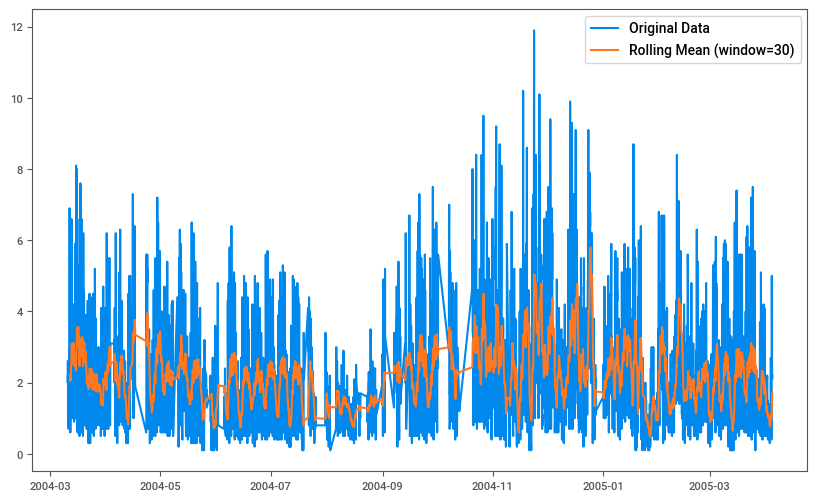

In [ ]:
# Calculate the rolling mean of a pollutant (e.g., CO(GT))
rolling_mean = df['CO(GT)'].rolling(window=30).mean()

# Plot the original data and the rolling mean
plt.figure(figsize=(10, 6))
plt.plot(df['CO(GT)'], label='Original Data')
plt.plot(rolling_mean, label='Rolling Mean (window=30)')
plt.legend()
plt.show()

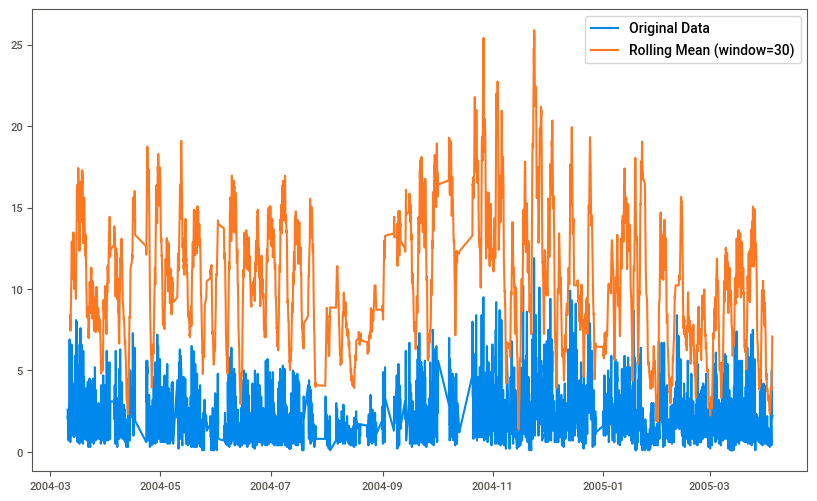

In [ ]:
# Calculate the rolling mean of a pollutant (e.g., CO(GT))
rolling_mean = df['C6H6(GT)'].rolling(window=30).mean()

# Plot the original data and the rolling mean
plt.figure(figsize=(10, 6))
plt.plot(df['CO(GT)'], label='Original Data')
plt.plot(rolling_mean, label='Rolling Mean (window=30)')
plt.legend()
plt.show()

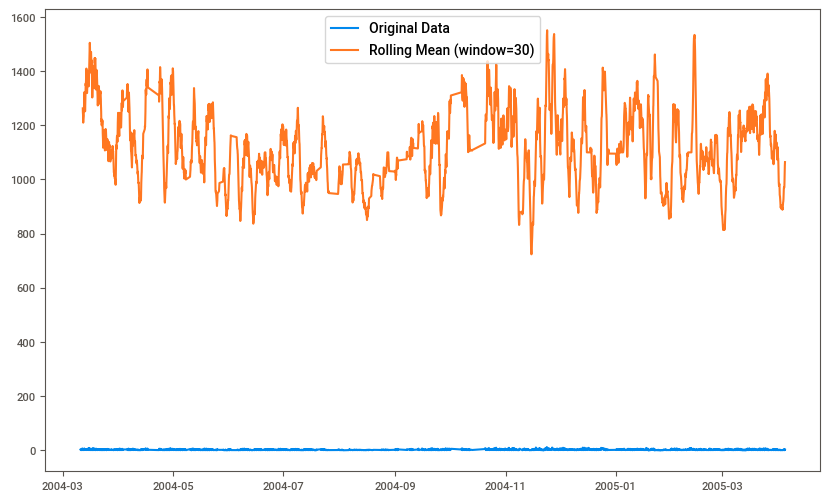

In [ ]:
# Calculate the rolling mean of a pollutant (e.g., CO(GT))
rolling_mean = df['PT08.S1(CO)'].rolling(window=30).mean()

# Plot the original data and the rolling mean
plt.figure(figsize=(10, 6))
plt.plot(df['CO(GT)'], label='Original Data')
plt.plot(rolling_mean, label='Rolling Mean (window=30)')
plt.legend()
plt.show()

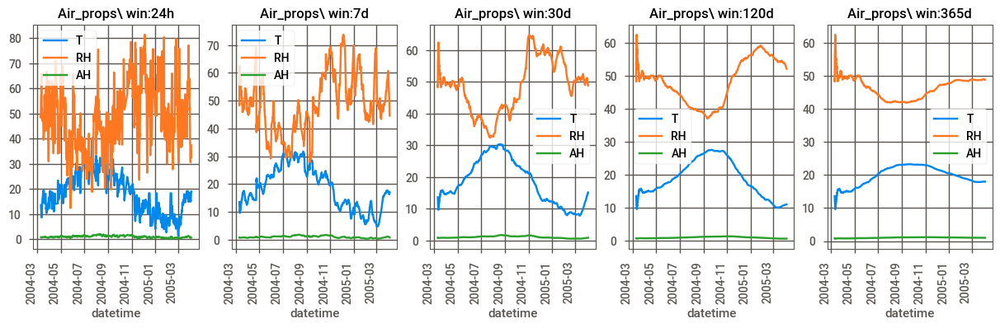

In [ ]:
# AIR PROPERTIES
airprops_cols = ['T','RH','AH']
rolling_freqs = ['24h', '7d','30d','120d','365d']
airprops = df[airprops_cols]

with plt.style.context('seaborn-notebook'):

    fig, axs = plt.subplots(1,len(rolling_freqs), figsize=(15,4))
    for i,freq in enumerate(rolling_freqs):
        airprops.rolling(freq).mean().plot(ax=axs[i], grid=True)
        axs[i].set_title("Air_props\ win:%s"%freq)
        labels = axs[i].get_xticks()
        plt.setp(axs[i].xaxis.get_majorticklabels(), rotation=90 )


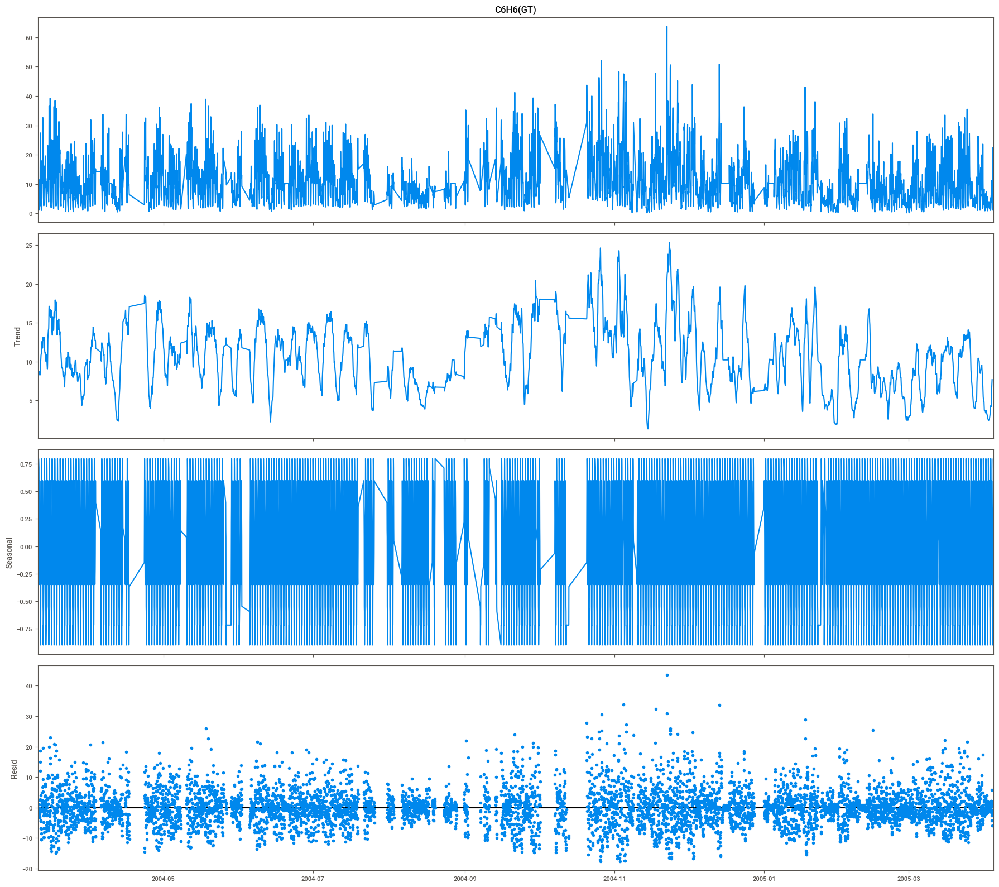

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(df['C6H6(GT)'], model='additive', period=24)
result.plot()
plt.show()

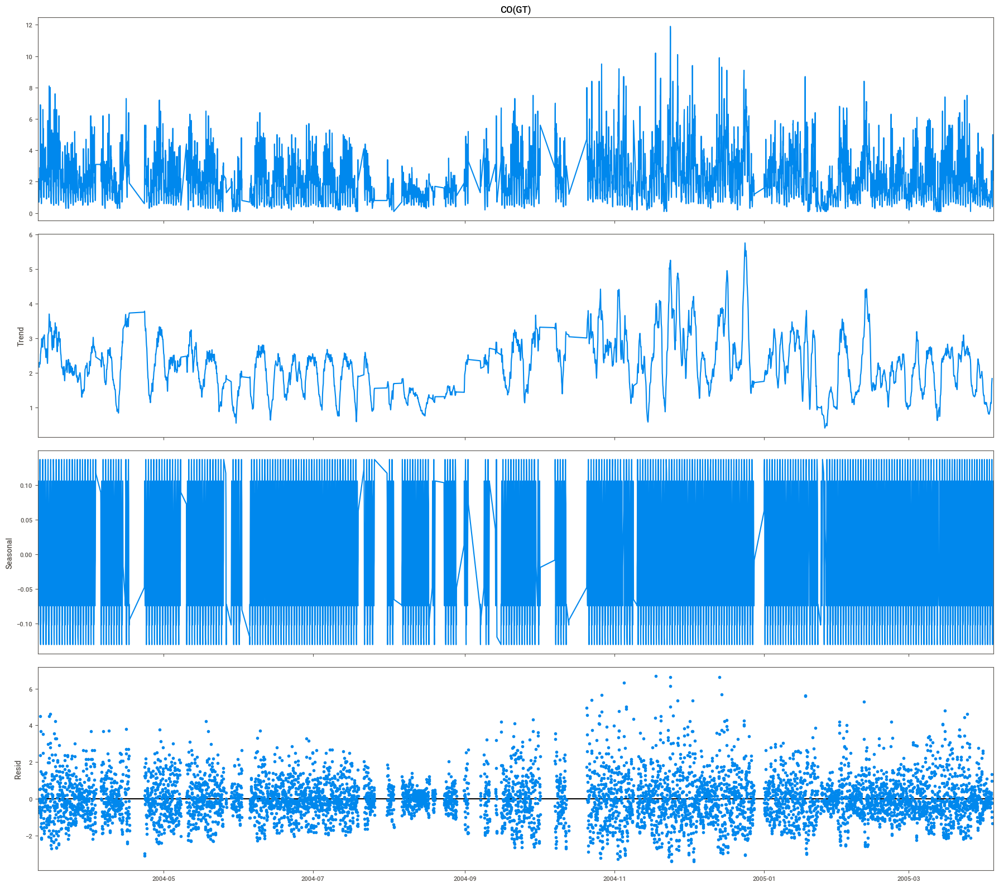

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(df['CO(GT)'], model='additive', period=24)
result.plot()
plt.show()

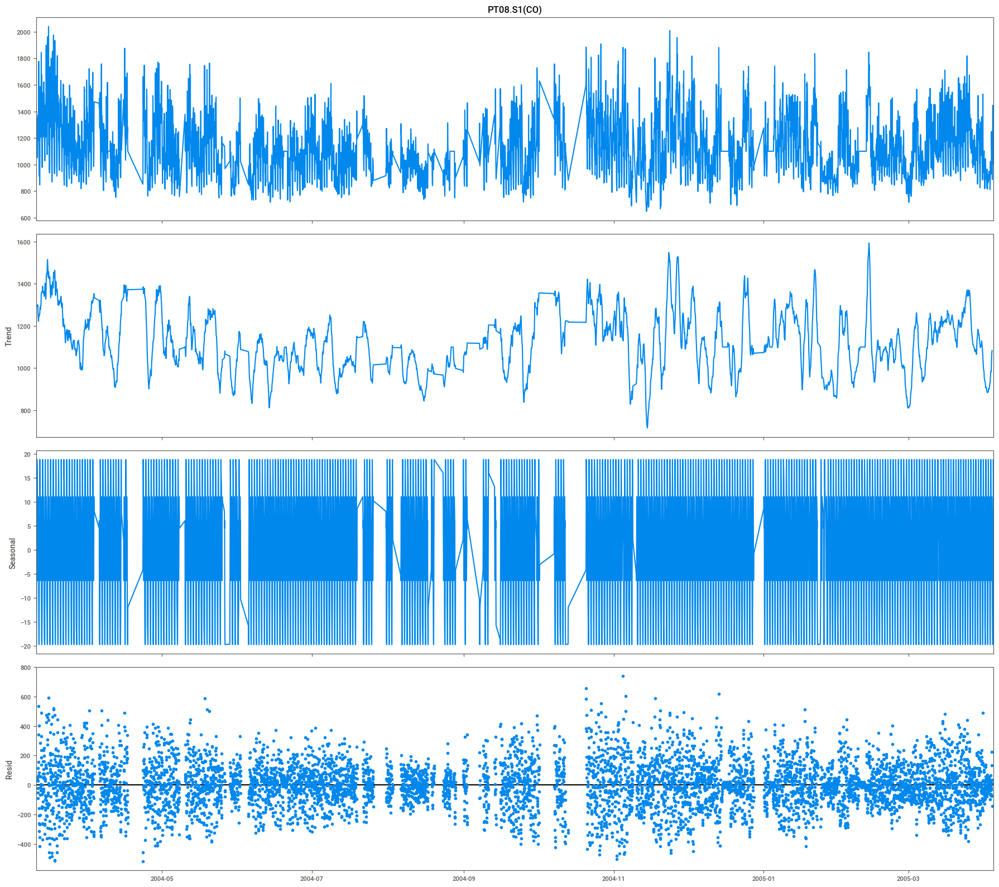

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(df['PT08.S1(CO)'], model='additive', period=24)
result.plot()
plt.show()

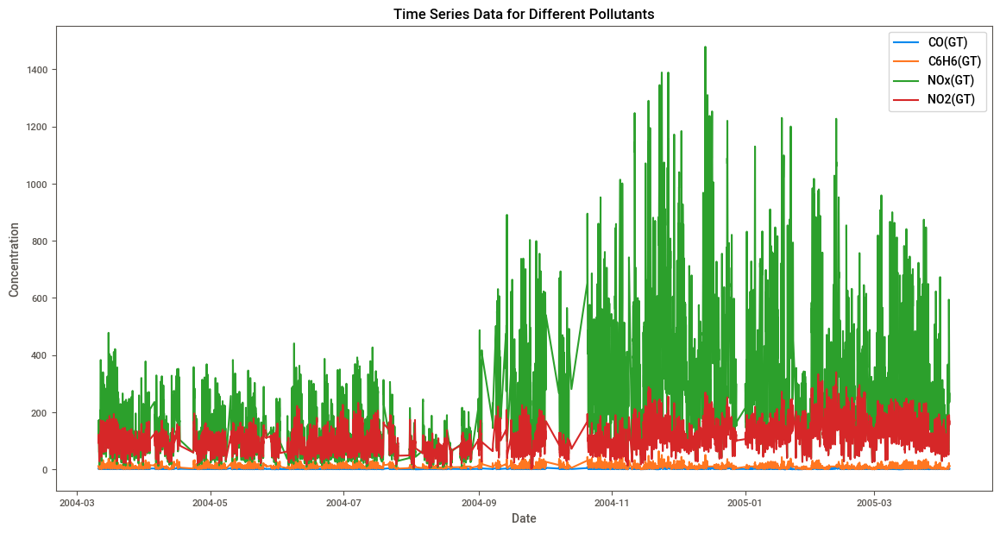

In [ ]:
pollutants=['CO(GT)','C6H6(GT)','NOx(GT)','NO2(GT)']
plt.figure(figsize=(14,7))
for i in pollutants:
    plt.plot(df.index, df[i], label=i)
plt.title('Time Series Data for Different Pollutants')
plt.xlabel('Date')
plt.ylabel('Concentration')
plt.legend()
plt.show()

## Feature Engineering:

In [ ]:
df['hour'] = df.index.hour
df['day'] = df.index.day
df['month'] = df.index.month
df['day_of_week'] = df.index.dayofweek

In [ ]:
df = df.drop(['T', 'RH', 'AH','Month'], axis=1)

In [ ]:
df= df.reset_index()

In [ ]:
df.head()

,datetime,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),hour,day,month,day_of_week
0,2004-03-10 18:00:00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,18,10,3,2
1,2004-03-10 19:00:00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,19,10,3,2
2,2004-03-10 20:00:00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,20,10,3,2
3,2004-03-10 21:00:00,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,21,10,3,2
4,2004-03-10 22:00:00,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,22,10,3,2


## Model Selection and Building:

In [ ]:
#Splitting the dataset into test and train data
#train data is 70% of the dataset
#test data is 30% of the dataset

In [ ]:
train_size = int(len(df) * 0.7)
train, test = df.iloc[:train_size], df.iloc[train_size:]

In [ ]:
## Test for stationarity of the series - Dicky Fuller test

from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries):

    #Determing rolling statistics
    rolmean = timeseries.rolling(window=7).mean()
    rolstd = timeseries.rolling(window=7).std()

    #Plot rolling statistics:
    orig = plt.plot(timeseries, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)

    #Perform Dickey-Fuller test:
    print ('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print (dfoutput,'\n')

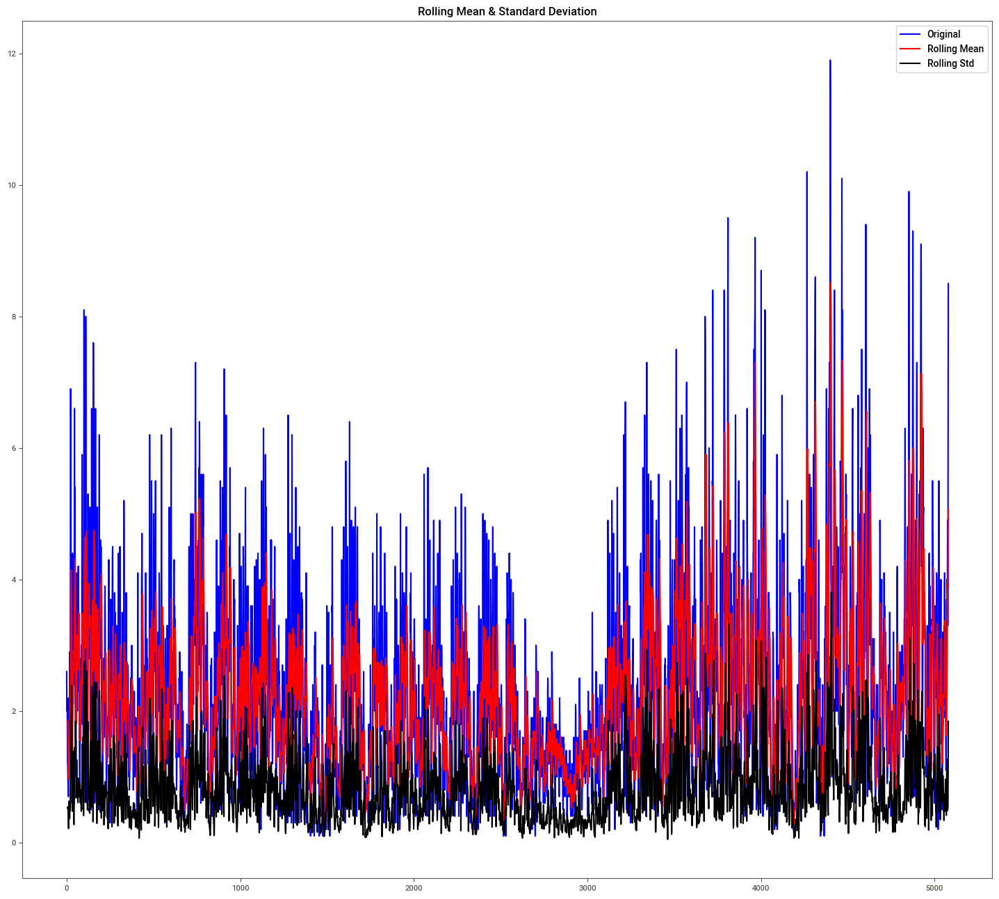

Results of Dickey-Fuller Test:
Test Statistic                -7.577210e+00
p-value                        2.741479e-11
#Lags Used                     3.200000e+01
Number of Observations Used    5.047000e+03
Critical Value (1%)           -3.431646e+00
Critical Value (5%)           -2.862113e+00
Critical Value (10%)          -2.567075e+00
dtype: float64 



In [ ]:
test_stationarity(train['CO(GT)'])

#### SARIMAX Model Building

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from sklearn.metrics import  mean_squared_error
from statsmodels.distributions.empirical_distribution import ECDF
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error
from math import sqrt
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from statsmodels.tsa.api import VAR
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression

In [ ]:
order = (1, 1, 1)  # Adjust order based on your analysis
seasonal_order = (1, 1, 1, 12)  # Adjust seasonal order based on your analysis
model = SARIMAX(train['CO(GT)'], order=order, seasonal_order=seasonal_order)
sarima_model = model.fit(disp=False)

# Forecasting
predictions = sarima_model.get_forecast(steps=len(test))
sarima_pred = predictions.predicted_mean

In [ ]:
print(sarima_model.summary())

                                     SARIMAX Results                                      
Dep. Variable:                             CO(GT)   No. Observations:                 5080
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood               -6366.732
Date:                            Sun, 05 May 2024   AIC                          12743.465
Time:                                    20:54:59   BIC                          12776.117
Sample:                                         0   HQIC                         12754.901
                                           - 5080                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1750      0.045     -3.875      0.000      -0.264      -0.086
ma.L1          0.3976      0.043   

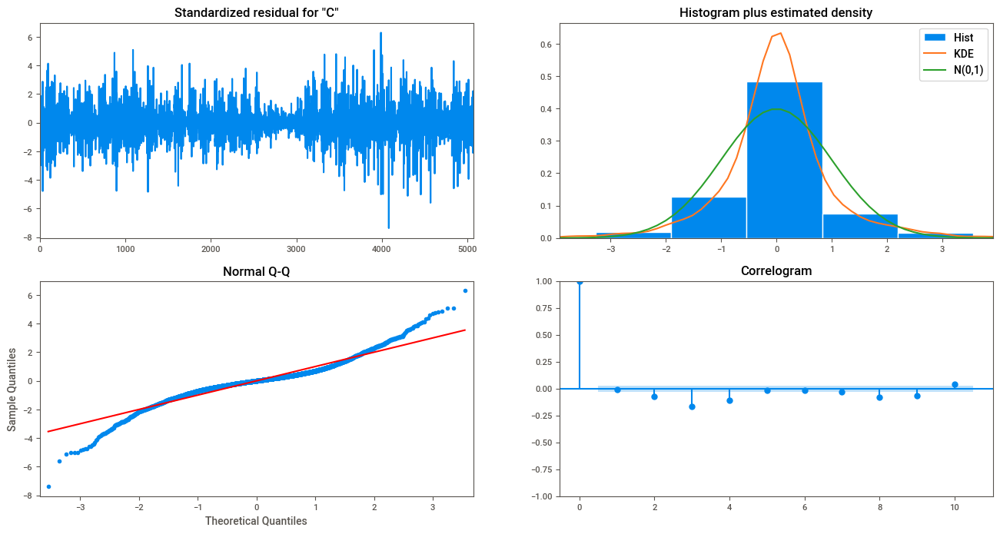

In [ ]:
sarima_model.plot_diagnostics(figsize=(16, 8))
plt.show()

SARIMA RMSE: 9.082825530561523


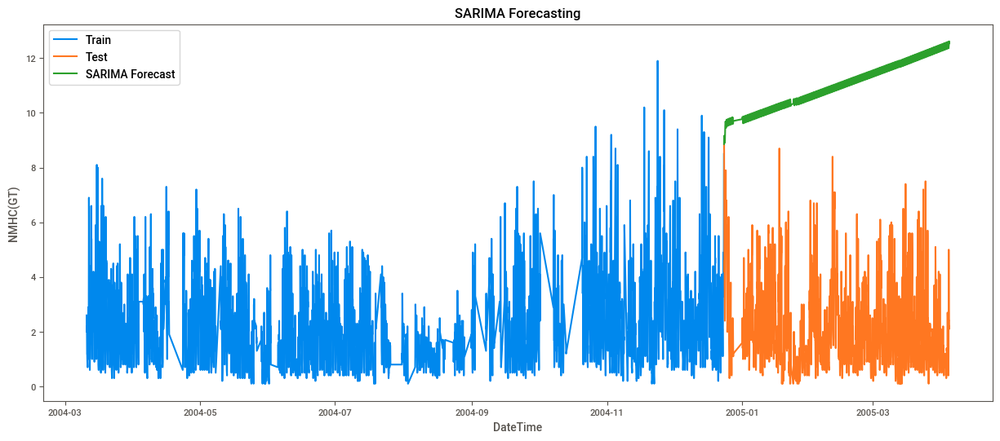

In [ ]:
# Evaluate the model
rmse = sqrt(mean_squared_error(test['CO(GT)'], sarima_pred))
print(f"SARIMA RMSE: {rmse}")

# Plotting the results
plt.figure(figsize=(15, 6))
plt.plot(train['datetime'], train['CO(GT)'], label='Train')
plt.plot(test['datetime'], test['CO(GT)'], label='Test')
plt.plot(test['datetime'], sarima_pred, label='SARIMA Forecast')
plt.title('SARIMA Forecasting')
plt.xlabel('DateTime')
plt.ylabel('NMHC(GT)')
plt.legend()
plt.show()

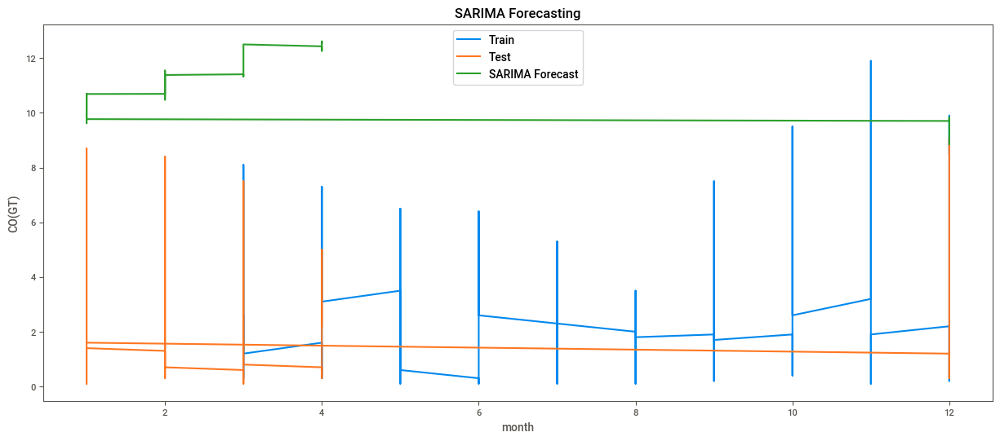

In [ ]:
# Plotting the results
plt.figure(figsize=(15, 6))
plt.plot(train['month'], train['CO(GT)'], label='Train')
plt.plot(test['month'], test['CO(GT)'], label='Test')
plt.plot(test['month'], sarima_pred, label='SARIMA Forecast')
plt.title('SARIMA Forecasting')
plt.xlabel('month')
plt.ylabel('CO(GT)')
plt.legend()
plt.show()

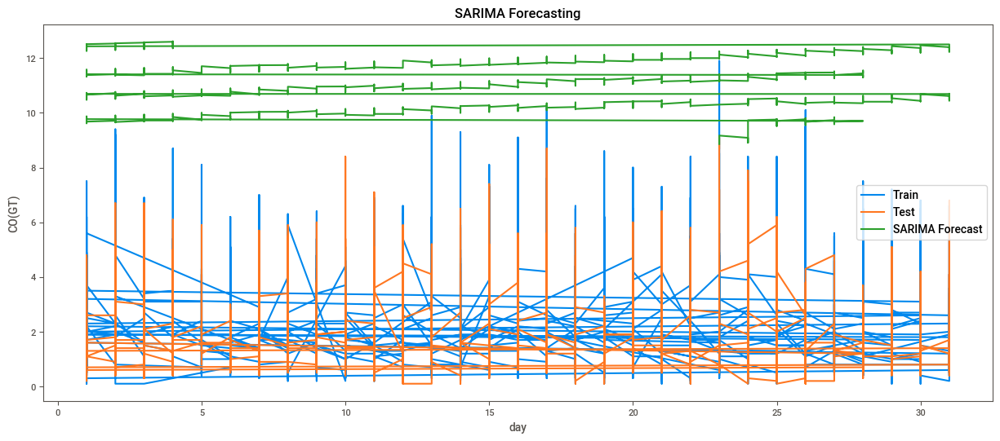

In [ ]:
# Plotting the results
plt.figure(figsize=(15, 6))
plt.plot(train['day'], train['CO(GT)'], label='Train')
plt.plot(test['day'], test['CO(GT)'], label='Test')
plt.plot(test['day'], sarima_pred, label='SARIMA Forecast')
plt.title('SARIMA Forecasting')
plt.xlabel('day')
plt.ylabel('CO(GT)')
plt.legend()
plt.show()

#### LSTM Model Buid  

In [ ]:
df = df.set_index('day')

In [ ]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(train['CO(GT)'].values.reshape(-1, 1))

In [ ]:
# Convert the data to a supervised learning problem
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

time_step = 10  # Adjust time step based on your analysis
X, y = create_dataset(scaled_data, time_step)

# Reshape data for LSTM
X = X.reshape(X.shape[0], X.shape[1], 1)

# Split the data into training and testing sets
train_size = int(len(X) * 0.7)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


In [ ]:
# Build LSTM model
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [ ]:

# Fit the model
model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=50, batch_size=64, verbose=1)


Epoch 1/50
56/56 [==============================] - 8s 57ms/step - loss: 0.0116 - val_loss: 0.0210
Epoch 2/50
56/56 [==============================] - 2s 28ms/step - loss: 0.0098 - val_loss: 0.0184
Epoch 3/50
56/56 [==============================] - 1s 22ms/step - loss: 0.0090 - val_loss: 0.0165
Epoch 4/50
56/56 [==============================] - 1s 26ms/step - loss: 0.0076 - val_loss: 0.0119
Epoch 5/50
56/56 [==============================] - 1s 21ms/step - loss: 0.0055 - val_loss: 0.0088
Epoch 6/50
56/56 [==============================] - 1s 21ms/step - loss: 0.0041 - val_loss: 0.0086
Epoch 7/50
56/56 [==============================] - 1s 22ms/step - loss: 0.0037 - val_loss: 0.0070
Epoch 8/50
56/56 [==============================] - 1s 22ms/step - loss: 0.0036 - val_loss: 0.0070
Epoch 9/50
56/56 [==============================] - 1s 22ms/step - loss: 0.0036 - val_loss: 0.0074
Epoch 10/50
56/56 [==============================] - 2s 28ms/step - loss: 0.0035 - val_loss: 0.0066
Epoch 11/

In [ ]:
# Make predictions
lstm_pred = model.predict(X_test)
lstm_pred = scaler.inverse_transform(lstm_pred)


48/48 [==============================] - 2s 6ms/step


In [ ]:
# Invert normalization for actual values
y_test = scaler.inverse_transform([y_test])

LSTM RMSE: 0.9944169797291197


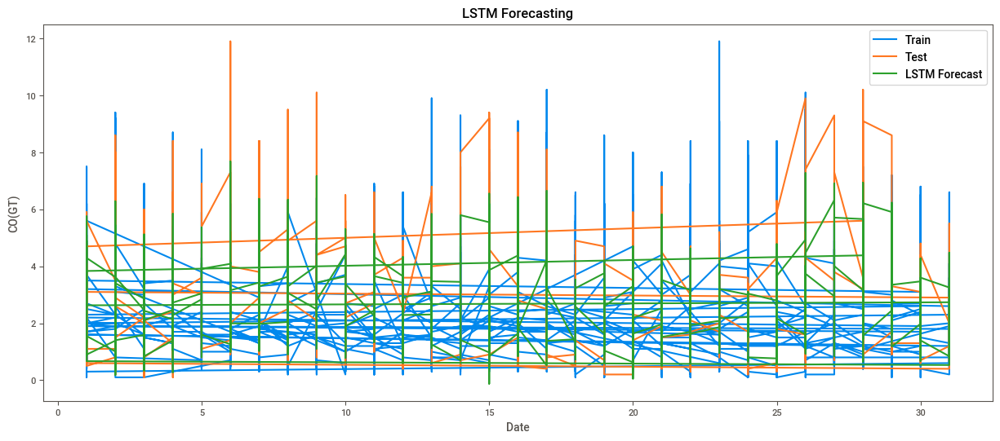

In [ ]:
# Evaluate the model
rmse = sqrt(mean_squared_error(y_test[0], lstm_pred[:, 0]))
print(f"LSTM RMSE: {rmse}")

# Plotting the results
plt.figure(figsize=(15, 6))
train_data = df.head(len(df) - len(X_test))
plt.plot(train_data.index, train_data['CO(GT)'], label='Train')
plt.plot(df.index[-len(X_test):], y_test[0], label='Test')
plt.plot(df.index[-len(X_test):], lstm_pred[:, 0], label='LSTM Forecast')
plt.title('LSTM Forecasting')
plt.xlabel('Date')
plt.ylabel('CO(GT)')
plt.legend()
plt.show()

In [ ]:
df = df.set_index('month')

LSTM RMSE: 0.9944169797291197


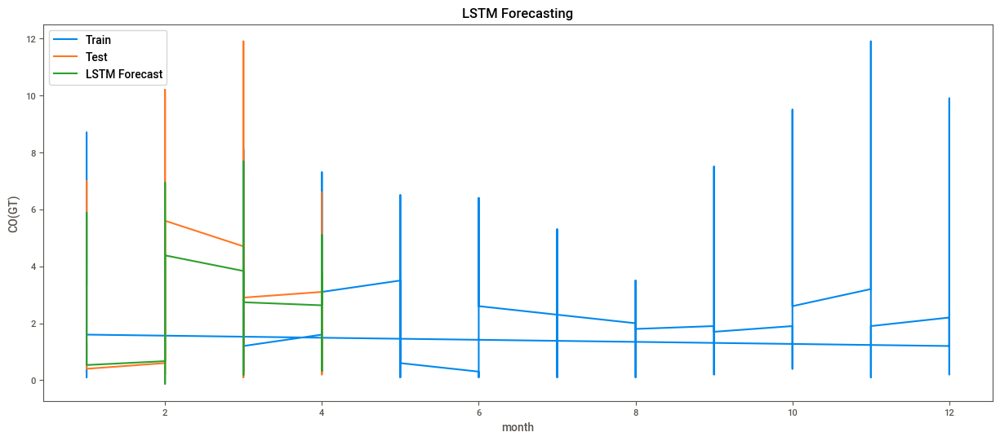

In [ ]:
# Evaluate the model
rmse = sqrt(mean_squared_error(y_test[0], lstm_pred[:, 0]))
print(f"LSTM RMSE: {rmse}")

# Plotting the results
plt.figure(figsize=(15, 6))
train_data = df.head(len(df) - len(X_test))
plt.plot(train_data.index, train_data['CO(GT)'], label='Train')
plt.plot(df.index[-len(X_test):], y_test[0], label='Test')
plt.plot(df.index[-len(X_test):], lstm_pred[:, 0], label='LSTM Forecast')
plt.title('LSTM Forecasting')
plt.xlabel('month')
plt.ylabel('CO(GT)')
plt.legend()
plt.show()

In [ ]:
df = df.set_index('datetime')

LSTM RMSE: 0.9944169797291197


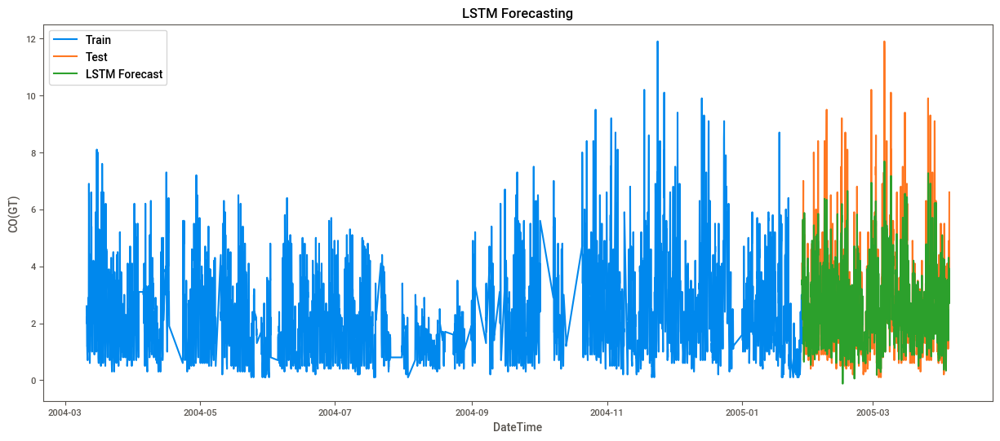

In [ ]:
# Evaluate the model
rmse = sqrt(mean_squared_error(y_test[0], lstm_pred[:, 0]))
print(f"LSTM RMSE: {rmse}")

# Plotting the results
plt.figure(figsize=(15, 6))
train_data = df.head(len(df) - len(X_test))
plt.plot(train_data.index, train_data['CO(GT)'], label='Train')
plt.plot(df.index[-len(X_test):], y_test[0], label='Test')
plt.plot(df.index[-len(X_test):], lstm_pred[:, 0], label='LSTM Forecast')
plt.title('LSTM Forecasting')
plt.xlabel('DateTime')
plt.ylabel('CO(GT)')
plt.legend()
plt.show()